In [14]:
import os
# arrange an instance segmentation model for test
from sahi.utils.yolov8 import (
    download_yolov8s_model, download_yolov8s_seg_model
)

from sahi import AutoDetectionModel
from sahi.utils.cv import read_image
from sahi.predict import get_prediction, get_sliced_prediction, predict
from IPython.display import Image
from matplotlib import pyplot as plt

import random
import cv2
import json
import os
from pycocotools.coco import COCO

In [16]:
detection_model = AutoDetectionModel.from_pretrained(
    model_type='yolov8',
    model_path='/home/sai/drone_ws/src/object_detect/runs/detect/yolov8_800_16_200_coslr_dropout05/weights/best.pt',
    confidence_threshold=0.5,
    device="cpu", # or 'cuda:0'
)

In [17]:
result = get_prediction("/home/sai/drone_ws/src/object_detect/data/VisImages/VisDrone2019-DET-test-dev/images/0000006_00159_d_0000001.jpg", detection_model)

In [18]:
result.object_prediction_list[0].bbox

BoundingBox: <(686.4392, 468.00748, 794.60565, 526.8967), w: 108.16644287109375, h: 58.889251708984375>

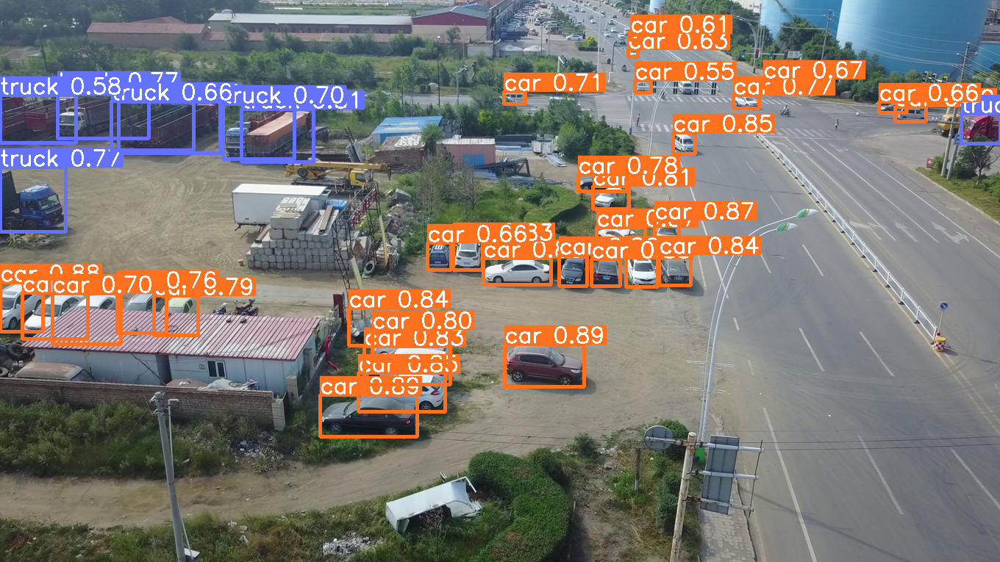

In [19]:
result.export_visuals(export_dir="demo_data/")

Image("demo_data/prediction_visual.png")

In [31]:
result = get_sliced_prediction(
    "/home/sai/drone_ws/src/object_detect/data/VisImages/VisDrone2019-DET-test-dev/images/0000006_00159_d_0000001.jpg",
    detection_model,
    slice_height = 720,
    slice_width = 720,
    overlap_height_ratio = 0.2,
    overlap_width_ratio = 0.2,
    postprocess_type = "NMS",
    postprocess_match_metric = "IOU",
    postprocess_match_threshold = 0.5,
)

Performing prediction on 6 slices.


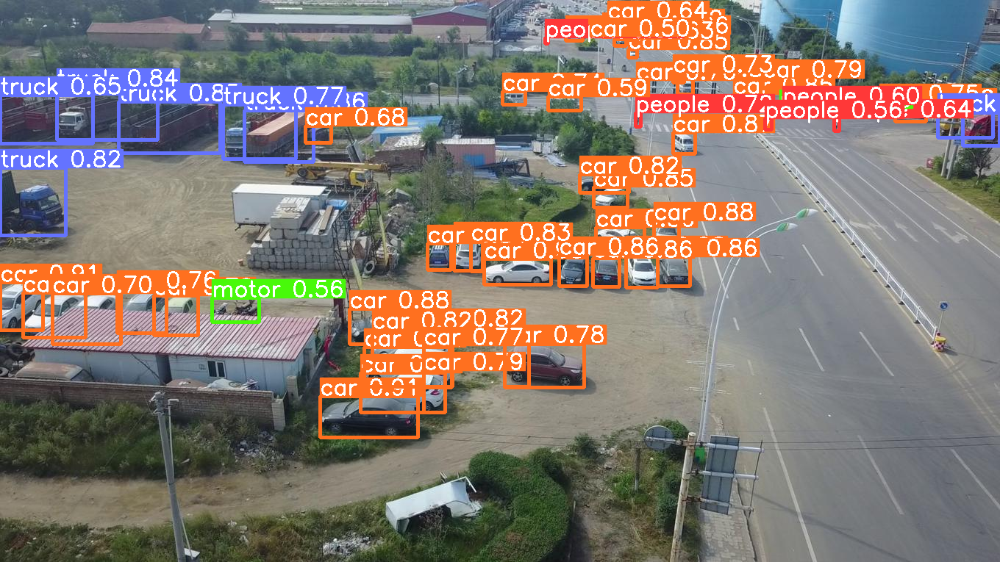

In [32]:
result.export_visuals(export_dir="demo_data/")

Image("demo_data/prediction_visual.png")

### test 3 random images from test data

In [30]:
# Paths
COCO_JSON = "/home/sai/drone_ws/src/object_detect/cfg/coco_annotations.json"
TEST_DATA_PATH = "/home/sai/drone_ws/src/object_detect/data/VisImages/VisDrone2019-DET-test-dev/images"

# Load COCO annotations
coco = COCO(COCO_JSON)

# Select three random images
image_ids = coco.getImgIds()
random_image_ids = random.sample(image_ids, 3)

loading annotations into memory...
Done (t=0.49s)
creating index...
index created!


### get original annotations

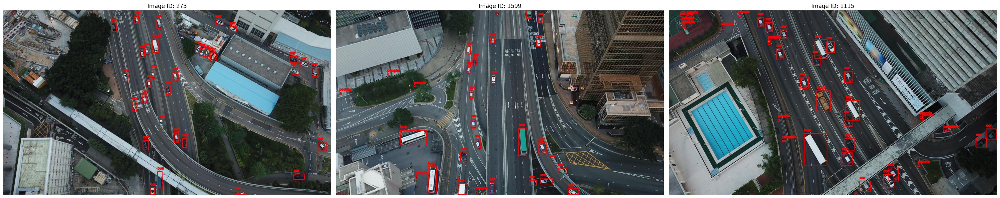

In [34]:
# Initialize a figure for plotting
fig, axes = plt.subplots(1, 3, figsize=(30, 30))

for i, image_id in enumerate(random_image_ids):
    # Get image details
    image_info = coco.loadImgs(image_id)[0]
    image_path = os.path.join(TEST_DATA_PATH, image_info['file_name'])
    image = cv2.imread(image_path)
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)  # Convert to RGB for Matplotlib

    # Get annotations for the image
    annotation_ids = coco.getAnnIds(imgIds=image_id)
    annotations = coco.loadAnns(annotation_ids)

    # Plot bounding boxes
    for ann in annotations:
        x, y, w, h = ann['bbox']
        category_id = ann['category_id']
        category_name = coco.loadCats(category_id)[0]['name']
        color = (255, 0, 0)  # Red color for bounding boxes
        thickness = 2

        # Draw the bounding box
        cv2.rectangle(image, (int(x), int(y)), (int(x + w), int(y + h)), color, thickness)
        # Add label
        cv2.putText(
            image,
            category_name,
            (int(x), int(y) - 10),
            cv2.FONT_HERSHEY_SIMPLEX,
            0.5,
            color,
            thickness,
            cv2.LINE_AA,
        )

    # Display image in the subplot
    axes[i].imshow(image)
    axes[i].axis("off")
    axes[i].set_title(f"Image ID: {image_id}")

# Adjust layout and display
plt.tight_layout()
plt.show()

### test yolo v8 and sahi

Performing prediction on 6 slices.
Performing prediction on 6 slices.
Performing prediction on 6 slices.


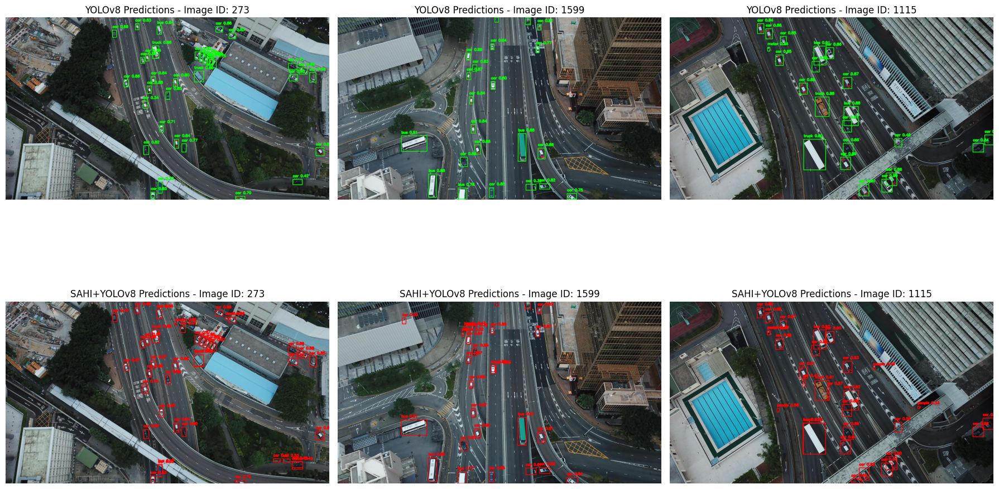

In [ ]:
# Load YOLOv8 model
detection_model = AutoDetectionModel.from_pretrained(
    model_type="yolov8",
    model_path='/home/sai/drone_ws/src/object_detect/runs/detect/yolov8_800_16_200_coslr_dropout05/weights/best.pt',
    confidence_threshold=0.3,
    device="cuda:0"
)

fig, axes = plt.subplots(3, 3, figsize=(18, 12))

for i, image_id in enumerate(random_image_ids):
    # Get image details
    image_info = coco.loadImgs(image_id)[0]
    image_path = os.path.join(TEST_DATA_PATH, image_info['file_name'])
    image = cv2.imread(image_path)
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)  # Convert to RGB for Matplotlib

    # YOLOv8 predictions
    yolov8_result = get_prediction(image_path, detection_model=detection_model)
    yolov8_image = image.copy()
    for pred in yolov8_result.object_prediction_list:
        x1, y1, x2, y2 = int(pred.bbox.minx), int(pred.bbox.miny), int(pred.bbox.maxx), int(pred.bbox.maxy)
        score = pred.score.value
        category_name = pred.category.name
        color = (0, 255, 0)  # Green color for bounding boxes
        thickness = 2
        cv2.rectangle(yolov8_image, (x1, y1), (x2, y2), color, thickness)
        cv2.putText(
            yolov8_image,
            f"{category_name} {score:.2f}",
            (x1, y1 - 10),
            cv2.FONT_HERSHEY_SIMPLEX,
            0.5,
            color,
            thickness,
            cv2.LINE_AA,
        )

    # SAHI-enhanced YOLOv8 predictions
    sahi_result = get_sliced_prediction(image_path,
        detection_model=detection_model,
        slice_height=720,
        slice_width=720,
        overlap_height_ratio=0.2,
        overlap_width_ratio=0.2,
    )
    sahi_image = image.copy()
    for pred in sahi_result.object_prediction_list:
        x1, y1, x2, y2 = int(pred.bbox.minx), int(pred.bbox.miny), int(pred.bbox.maxx), int(pred.bbox.maxy)
        score = pred.score.value
        category_name = pred.category.name
        color = (255, 0, 0)  # Red color for bounding boxes
        thickness = 2
        cv2.rectangle(sahi_image, (x1, y1), (x2, y2), color, thickness)
        cv2.putText(
            sahi_image,
            f"{category_name} {score:.2f}",
            (x1, y1 - 10),
            cv2.FONT_HERSHEY_SIMPLEX,
            0.5,
            color,
            thickness,
            cv2.LINE_AA,
        )

    # Display YOLOv8 predictions
    axes[0, i].imshow(yolov8_image)
    axes[0, i].axis("off")
    axes[0, i].set_title(f"YOLOv8 Predictions - Image ID: {image_id}")

    # Display SAHI+YOLOv8 predictions
    axes[1, i].imshow(sahi_image)
    axes[1, i].axis("off")
    axes[1, i].set_title(f"SAHI+YOLOv8 Predictions - Image ID: {image_id}")

# Adjust layout and display
plt.tight_layout()
plt.show()

Performing prediction on 6 slices.
Performing prediction on 6 slices.


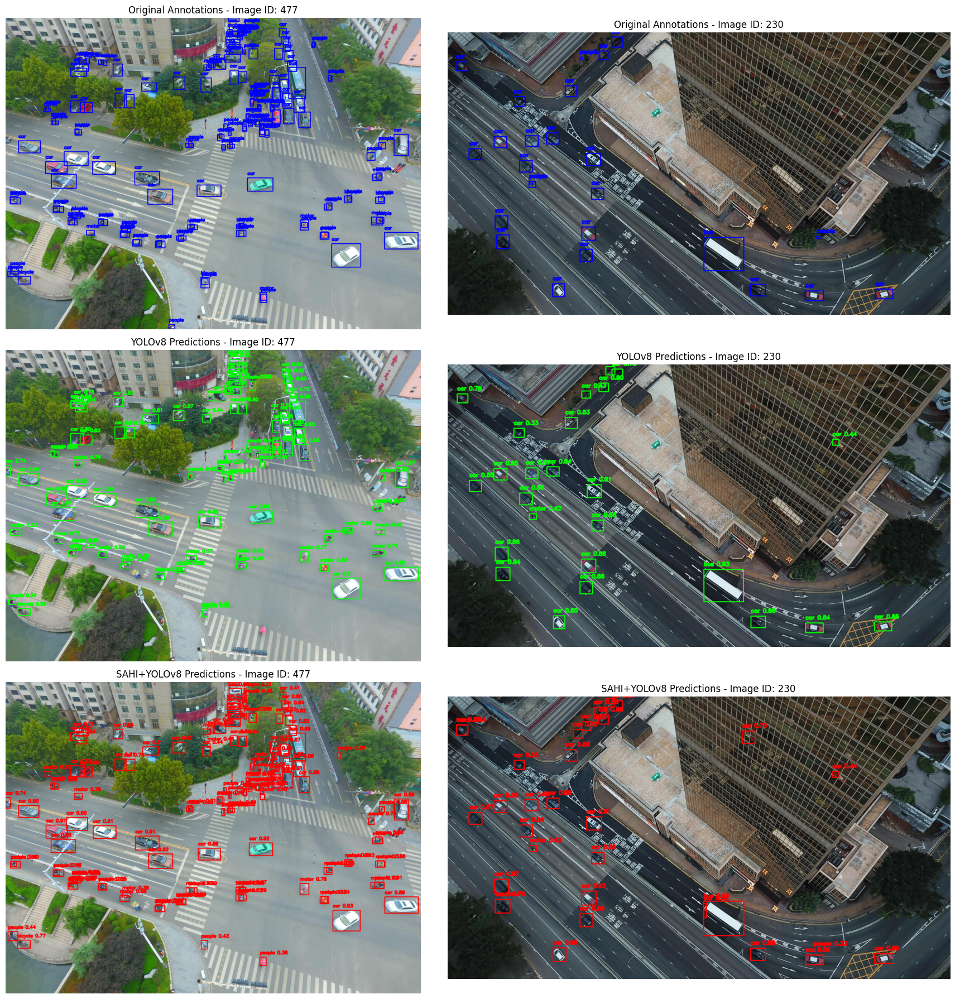

In [44]:
# Load YOLOv8 model
detection_model = AutoDetectionModel.from_pretrained(
    model_type="yolov8",
    model_path='/home/sai/drone_ws/src/object_detect/runs/detect/yolov8_800_16_200_coslr_dropout05/weights/best.pt',
    confidence_threshold=0.3,
    device="cuda:0"  # Change to "cpu" if GPU is not available
)

# Select three random images
image_ids = coco.getImgIds()
random_image_ids = random.sample(image_ids, 2)

# Initialize a figure for plotting
fig, axes = plt.subplots(3, 2, figsize=(18, 18))

for i, image_id in enumerate(random_image_ids):
    # Get image details
    image_info = coco.loadImgs(image_id)[0]
    image_path = os.path.join(TEST_DATA_PATH, image_info['file_name'])
    image = cv2.imread(image_path)
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)  # Convert to RGB for Matplotlib

    # Original annotations
    original_image = image.copy()
    annotation_ids = coco.getAnnIds(imgIds=image_id)
    annotations = coco.loadAnns(annotation_ids)
    for ann in annotations:
        x, y, w, h = ann['bbox']
        category_name = coco.loadCats(ann['category_id'])[0]['name']
        color = (0, 0, 255)  # Blue color for original annotations
        thickness = 2
        cv2.rectangle(original_image, (int(x), int(y)), (int(x + w), int(y + h)), color, thickness)
        cv2.putText(
            original_image,
            category_name,
            (int(x), int(y) - 10),
            cv2.FONT_HERSHEY_SIMPLEX,
            0.5,
            color,
            thickness,
            cv2.LINE_AA,
        )

    # YOLOv8 predictions
    yolov8_result = get_prediction(image_path, detection_model=detection_model)
    yolov8_image = image.copy()
    for pred in yolov8_result.object_prediction_list:
        x1, y1, x2, y2 = int(pred.bbox.minx), int(pred.bbox.miny), int(pred.bbox.maxx), int(pred.bbox.maxy)
        score = pred.score.value
        category_name = pred.category.name
        color = (0, 255, 0)  # Green color for YOLOv8 predictions
        thickness = 2
        cv2.rectangle(yolov8_image, (x1, y1), (x2, y2), color, thickness)
        cv2.putText(
            yolov8_image,
            f"{category_name} {score:.2f}",
            (x1, y1 - 10),
            cv2.FONT_HERSHEY_SIMPLEX,
            0.5,
            color,
            thickness,
            cv2.LINE_AA,
        )

    # SAHI-enhanced YOLOv8 predictions
    sahi_result = get_sliced_prediction(image_path,
        detection_model=detection_model,
        slice_height=720,
        slice_width=720,
        overlap_height_ratio=0.2,
        overlap_width_ratio=0.2,
    )
    sahi_image = image.copy()
    for pred in sahi_result.object_prediction_list:
        x1, y1, x2, y2 = int(pred.bbox.minx), int(pred.bbox.miny), int(pred.bbox.maxx), int(pred.bbox.maxy)
        score = pred.score.value
        category_name = pred.category.name
        color = (255, 0, 0)  # Red color for SAHI+YOLOv8 predictions
        thickness = 2
        cv2.rectangle(sahi_image, (x1, y1), (x2, y2), color, thickness)
        cv2.putText(
            sahi_image,
            f"{category_name} {score:.2f}",
            (x1, y1 - 10),
            cv2.FONT_HERSHEY_SIMPLEX,
            0.5,
            color,
            thickness,
            cv2.LINE_AA,
        )

    # Display Original Annotations
    axes[0, i].imshow(original_image)
    axes[0, i].axis("off")
    axes[0, i].set_title(f"Original Annotations - Image ID: {image_id}")

    # Display YOLOv8 predictions
    axes[1, i].imshow(yolov8_image)
    axes[1, i].axis("off")
    axes[1, i].set_title(f"YOLOv8 Predictions - Image ID: {image_id}")

    # Display SAHI+YOLOv8 predictions
    axes[2, i].imshow(sahi_image)
    axes[2, i].axis("off")
    axes[2, i].set_title(f"SAHI+YOLOv8 Predictions - Image ID: {image_id}")

# Adjust layout and display
plt.tight_layout()
plt.show()

### test yolo v11 and sahi

Performing prediction on 6 slices.
Performing prediction on 6 slices.


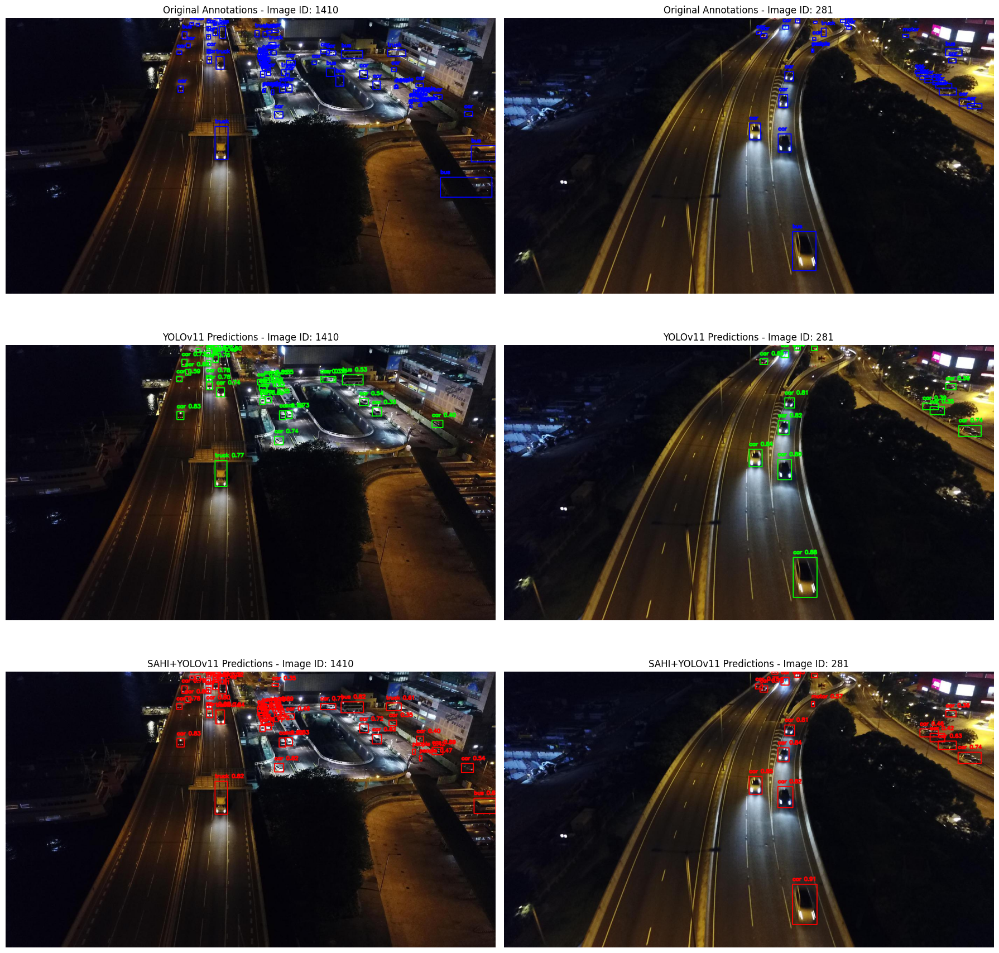

In [ ]:
# Load YOLOv11 model
detection_model = AutoDetectionModel.from_pretrained(
    model_type="yolov8",
    model_path='/home/sai/drone_ws/src/object_detect/runs/detect/yolo11_800_16_200_coslr_dropout05/weights/best.pt',
    confidence_threshold=0.3,
    device="cuda:0"  # Change to "cpu" if GPU is not available
)

# Select three random images
image_ids = coco.getImgIds()
random_image_ids = random.sample(image_ids, 2)

# Initialize a figure for plotting
fig, axes = plt.subplots(3, 2, figsize=(18, 18))

for i, image_id in enumerate(random_image_ids):
    # Get image details
    image_info = coco.loadImgs(image_id)[0]
    image_path = os.path.join(TEST_DATA_PATH, image_info['file_name'])
    image = cv2.imread(image_path)
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)  # Convert to RGB for Matplotlib

    # Original annotations
    original_image = image.copy()
    annotation_ids = coco.getAnnIds(imgIds=image_id)
    annotations = coco.loadAnns(annotation_ids)
    for ann in annotations:
        x, y, w, h = ann['bbox']
        category_name = coco.loadCats(ann['category_id'])[0]['name']
        color = (0, 0, 255)  # Blue color for original annotations
        thickness = 2
        cv2.rectangle(original_image, (int(x), int(y)), (int(x + w), int(y + h)), color, thickness)
        cv2.putText(
            original_image,
            category_name,
            (int(x), int(y) - 10),
            cv2.FONT_HERSHEY_SIMPLEX,
            0.5,
            color,
            thickness,
            cv2.LINE_AA,
        )

    # YOLOv11 predictions
    yolov11_result = get_prediction(image_path, detection_model=detection_model)
    yolov11_image = image.copy()
    for pred in yolov11_result.object_prediction_list:
        x1, y1, x2, y2 = int(pred.bbox.minx), int(pred.bbox.miny), int(pred.bbox.maxx), int(pred.bbox.maxy)
        score = pred.score.value
        category_name = pred.category.name
        color = (0, 255, 0)  # Green color for YOLOv8 predictions
        thickness = 2
        cv2.rectangle(yolov11_image, (x1, y1), (x2, y2), color, thickness)
        cv2.putText(
            yolov11_image,
            f"{category_name} {score:.2f}",
            (x1, y1 - 10),
            cv2.FONT_HERSHEY_SIMPLEX,
            0.5,
            color,
            thickness,
            cv2.LINE_AA,
        )

    # SAHI-enhanced YOLOv11 predictions
    sahi_result = get_sliced_prediction(image_path,
        detection_model=detection_model,
        slice_height=720,
        slice_width=720,
        overlap_height_ratio=0.2,
        overlap_width_ratio=0.2,
    )
    sahi_image = image.copy()
    for pred in sahi_result.object_prediction_list:
        x1, y1, x2, y2 = int(pred.bbox.minx), int(pred.bbox.miny), int(pred.bbox.maxx), int(pred.bbox.maxy)
        score = pred.score.value
        category_name = pred.category.name
        color = (255, 0, 0)  # Red color for SAHI+YOLOv8 predictions
        thickness = 2
        cv2.rectangle(sahi_image, (x1, y1), (x2, y2), color, thickness)
        cv2.putText(
            sahi_image,
            f"{category_name} {score:.2f}",
            (x1, y1 - 10),
            cv2.FONT_HERSHEY_SIMPLEX,
            0.5,
            color,
            thickness,
            cv2.LINE_AA,
        )

    # Display Original Annotations
    axes[0, i].imshow(original_image)
    axes[0, i].axis("off")
    axes[0, i].set_title(f"Original Annotations - Image ID: {image_id}")

    # Display YOLOv8 predictions
    axes[1, i].imshow(yolov11_image)
    axes[1, i].axis("off")
    axes[1, i].set_title(f"YOLOv11 Predictions - Image ID: {image_id}")

    # Display SAHI+YOLOv8 predictions
    axes[2, i].imshow(sahi_image)
    axes[2, i].axis("off")
    axes[2, i].set_title(f"SAHI+YOLOv11 Predictions - Image ID: {image_id}")

# Adjust layout and display
plt.tight_layout()
plt.show()

### test rt-detr and sahi

Performing prediction on 6 slices.
Performing prediction on 6 slices.


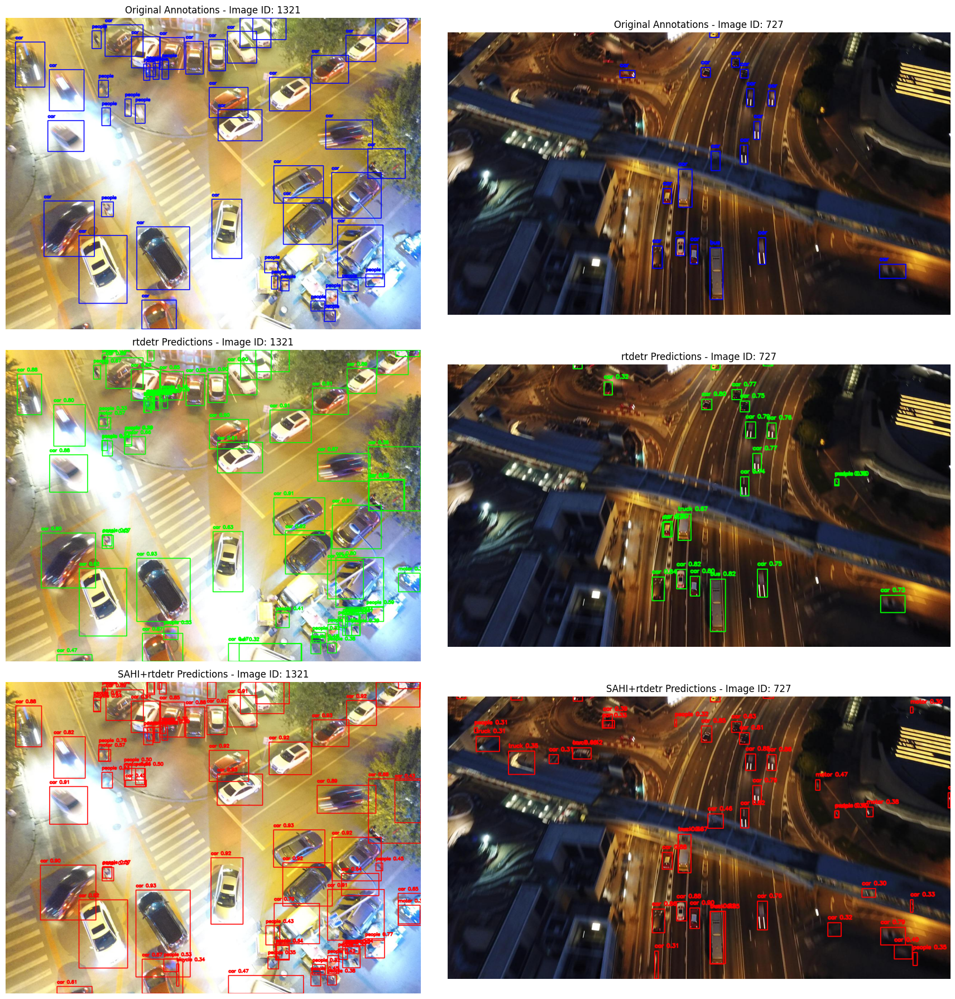

In [48]:
# Load YOLOv11 model
detection_model = AutoDetectionModel.from_pretrained(
    model_type="rtdetr",
    model_path='/home/sai/drone_ws/src/object_detect/runs/detect/rtdetr_800_16_200_coslr_dropout05/weights/best.pt',
    confidence_threshold=0.3,
    device="cuda:0"  # Change to "cpu" if GPU is not available
)

# Select three random images
image_ids = coco.getImgIds()
random_image_ids = random.sample(image_ids, 2)

# Initialize a figure for plotting
fig, axes = plt.subplots(3, 2, figsize=(18, 18))

for i, image_id in enumerate(random_image_ids):
    # Get image details
    image_info = coco.loadImgs(image_id)[0]
    image_path = os.path.join(TEST_DATA_PATH, image_info['file_name'])
    image = cv2.imread(image_path)
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)  # Convert to RGB for Matplotlib

    # Original annotations
    original_image = image.copy()
    annotation_ids = coco.getAnnIds(imgIds=image_id)
    annotations = coco.loadAnns(annotation_ids)
    for ann in annotations:
        x, y, w, h = ann['bbox']
        category_name = coco.loadCats(ann['category_id'])[0]['name']
        color = (0, 0, 255)  # Blue color for original annotations
        thickness = 2
        cv2.rectangle(original_image, (int(x), int(y)), (int(x + w), int(y + h)), color, thickness)
        cv2.putText(
            original_image,
            category_name,
            (int(x), int(y) - 10),
            cv2.FONT_HERSHEY_SIMPLEX,
            0.5,
            color,
            thickness,
            cv2.LINE_AA,
        )

    rtdetr_result = get_prediction(image_path, detection_model=detection_model)
    rtdetr_image = image.copy()
    for pred in rtdetr_result.object_prediction_list:
        x1, y1, x2, y2 = int(pred.bbox.minx), int(pred.bbox.miny), int(pred.bbox.maxx), int(pred.bbox.maxy)
        score = pred.score.value
        category_name = pred.category.name
        color = (0, 255, 0)  # Green color for YOLOv8 predictions
        thickness = 2
        cv2.rectangle(rtdetr_image, (x1, y1), (x2, y2), color, thickness)
        cv2.putText(
            rtdetr_image,
            f"{category_name} {score:.2f}",
            (x1, y1 - 10),
            cv2.FONT_HERSHEY_SIMPLEX,
            0.5,
            color,
            thickness,
            cv2.LINE_AA,
        )

    # SAHI-enhanced rtdetr predictions
    sahi_result = get_sliced_prediction(image_path,
        detection_model=detection_model,
        slice_height=720,
        slice_width=720,
        overlap_height_ratio=0.2,
        overlap_width_ratio=0.2,
    )
    sahi_image = image.copy()
    for pred in sahi_result.object_prediction_list:
        x1, y1, x2, y2 = int(pred.bbox.minx), int(pred.bbox.miny), int(pred.bbox.maxx), int(pred.bbox.maxy)
        score = pred.score.value
        category_name = pred.category.name
        color = (255, 0, 0)  # Red color for SAHI+YOLOv8 predictions
        thickness = 2
        cv2.rectangle(sahi_image, (x1, y1), (x2, y2), color, thickness)
        cv2.putText(
            sahi_image,
            f"{category_name} {score:.2f}",
            (x1, y1 - 10),
            cv2.FONT_HERSHEY_SIMPLEX,
            0.5,
            color,
            thickness,
            cv2.LINE_AA,
        )

    # Display Original Annotations
    axes[0, i].imshow(original_image)
    axes[0, i].axis("off")
    axes[0, i].set_title(f"Original Annotations - Image ID: {image_id}")

    # Display rtdetr predictions
    axes[1, i].imshow(rtdetr_image)
    axes[1, i].axis("off")
    axes[1, i].set_title(f"rtdetr Predictions - Image ID: {image_id}")

    # Display SAHI+YOLOv8 predictions
    axes[2, i].imshow(sahi_image)
    axes[2, i].axis("off")
    axes[2, i].set_title(f"SAHI+rtdetr Predictions - Image ID: {image_id}")

# Adjust layout and display
plt.tight_layout()
plt.show()

### test sahi with different slice height/width

In [ ]:
model_result = get_prediction(image_path, detection_model=detection_model)

### test sahi with different overlap

### test sahi with different process types

### test sahi with different postprocess_match_metric

### test sahi with different postprocess_match_threshold

### visualize sliced images (for one image)